In [1]:
import pandas as pd
import numpy as np
from pymgrid import Microgrid
from pymgrid.modules import (BatteryModule, LoadModule, RenewableModule, GridModule)


DEMAND_CHG_DATA_LOCATION = "ucsd-dataset/UCSD_Microgrid_Database/Data Files/DemandCharge.csv"
demand_charge_data = pd.read_csv(DEMAND_CHG_DATA_LOCATION, parse_dates=['DateTime'])
demand_charge_data.set_index('DateTime', inplace=True)
# Ensure data is old to new
demand_charge_data.sort_index(inplace=True, ascending=True)

# Per-module data
campus_generated_energy = demand_charge_data['OnCampusGeneration'].to_numpy()
# Generation can't be negative for the purposes of this model even though it is in a few places in the dataset
campus_generated_energy = campus_generated_energy.clip(min=0)
campus_load = demand_charge_data['TotalCampusLoad'].to_numpy()
# Avg cost of electricity in SD is 0.42 cents/kilowatt hr: https://www.energysage.com/local-data/electricity-cost/ca/san-diego-county/#:~:text=Electric%20rates%20in%20San%20Diego%20County%2C%20CA,-The%20easiest%20way&text=The%20average%20residential%20electricity%20rate,California%20of%2032.18%20¢%2FkWh.
# Avg amnt of co2 produced per kWh is 475 g: https://www.iea.org/reports/global-energy-co2-status-report-2019/emissions#:~:text=Today%20the%20average%20carbon%20intensity,of%20current%20power%20sector%20emissions.
# import price, export price, co2 per kWh
ts_grid = np.array([[0.42, 0, 475] for x in range(campus_load.size)])

battery1 = BatteryModule(min_capacity=10, max_capacity=5000, max_charge=2500, max_discharge=2500, efficiency=0.9, init_soc=0.5)
battery2 = BatteryModule(min_capacity=10, max_capacity=200000, max_charge=100000, max_discharge=100000, efficiency=0.9, init_soc=0.5)
renewable_energy = RenewableModule(time_series=campus_generated_energy)
load = LoadModule(time_series=campus_load)
grid = GridModule(max_import=50000, max_export=50000, time_series=ts_grid)

modules = [battery1, battery2, renewable_energy, load, grid]

ucsd_microgrid = Microgrid(modules, add_unbalanced_module=True)

print(ucsd_microgrid)

Microgrid([load x 1, renewable x 1, balancing x 1, battery x 2, grid x 1])


In [2]:

from pymgrid_simulator import PymgridNeuralNetworkMDP
import pandas as pd

def analyze_performance(grid_number=0, microgrid=None, end_step=None):
    learning_rate = 0.1
    discount_factor = 0.6
    num_episodes = 1
    mdp = PymgridNeuralNetworkMDP(learning_rate, discount_factor, grid_num=grid_number, microgrid=microgrid, end_step=end_step)
    rewards = mdp.train(episodes=num_episodes, epsilon=0.2)
    total_reward, action_log, timestamps, microgrid_log = mdp.run_inference()
    print("Total Reward during Inference:", total_reward)
    random_reward, rand_actions, rand_timestamps, rand_mg_log = mdp.random_action_baseline()
    print("Total Reward for Random:", random_reward)

    # from example
    try:
        # Plot based on example from pymgrid:
        microgrid_log.loc[:, pd.IndexSlice[:, :, 'reward']].cumsum().plot(title='Cost for NN MDP')
        rand_mg_log.loc[:, pd.IndexSlice[:, :, 'reward']].cumsum().plot(title='Cost for Random Baseline')
        microgrid_log.loc[:, pd.IndexSlice[:, :, 'co2_production']].cumsum().plot(title='CO2 for NN MDP')
        rand_mg_log.loc[:, pd.IndexSlice[:, :, 'co2_production']].cumsum().plot(title='CO2 for Random Baseline')
    except:
        return microgrid_log
    try:
        microgrid_log[[('load', 0, 'load_current'),
                ('pv', 0, 'renewable_used'), ('battery', 0, 'discharge_amount'), ('battery', 1, 'discharge_amount')]].droplevel(axis=1, level=1).plot()
    except:
        return microgrid_log
    try:
        microgrid_log[[('battery', 0, 'current_charge'), ('battery', 1, 'current_charge')]].droplevel(axis=1, level=1).plot()
    except:
        return microgrid_log
    try:
        # Plot based on example from pymgrid
        microgrid_log[[('load', 0, 'load_met')]].droplevel(axis=1, level=1).plot()
    except:
        try: 
            microgrid_log[[
                    ('unbalanced_energy', 0, 'loss_load')]].droplevel(axis=1, level=1).plot()
        except:
            return microgrid_log
    return microgrid_log


In [ ]:
from pymgrid_simulator import PymgridParameterizedMDP

def analyze_performance_parameterized(grid_number=0, microgrid=None, end_step=None):
    learning_rate = 0.1
    discount_factor = 0.6
    num_episodes = 1
    mdp = PymgridParameterizedMDP(learning_rate, discount_factor, grid_num=grid_number, microgrid=microgrid, end_step=end_step)
    rewards = mdp.train(episodes=num_episodes)
    total_reward, action_log, timestamps, microgrid_log = mdp.run_inference()
    print("Total Reward during Inference:", total_reward)
    random_reward, rand_actions, rand_timestamps, rand_mg_log = mdp.random_action_baseline()
    print("Total Reward for Random:", random_reward)

    # from example
    try:
        # Plot based on example from pymgrid:
        microgrid_log.loc[:, pd.IndexSlice[:, :, 'reward']].cumsum().plot(title='Cost for NN MDP')
        rand_mg_log.loc[:, pd.IndexSlice[:, :, 'reward']].cumsum().plot(title='Cost for Random Baseline')
        microgrid_log.loc[:, pd.IndexSlice[:, :, 'co2_production']].cumsum().plot(title='CO2 for NN MDP')
        rand_mg_log.loc[:, pd.IndexSlice[:, :, 'co2_production']].cumsum().plot(title='CO2 for Random Baseline')
    except:
        return microgrid_log
    try:
        microgrid_log[[('load', 0, 'load_current'),
                ('pv', 0, 'renewable_used'), ('battery', 0, 'discharge_amount'), ('battery', 1, 'discharge_amount')]].droplevel(axis=1, level=1).plot()
    except:
        return microgrid_log
    try:
        microgrid_log[[('battery', 0, 'current_charge'), ('battery', 1, 'current_charge')]].droplevel(axis=1, level=1).plot()
    except:
        return microgrid_log
    try:
        # Plot based on example from pymgrid
        microgrid_log[[('load', 0, 'load_met')]].droplevel(axis=1, level=1).plot()
    except:
        try: 
            microgrid_log[[
                    ('unbalanced_energy', 0, 'loss_load')]].droplevel(axis=1, level=1).plot()
        except:
            return microgrid_log
    return microgrid_log

In [5]:
param_microgrid_log = analyze_performance_parameterized(microgrid=ucsd_microgrid, end_step=75843)

/Users/jazz/opt/anaconda3/lib/python3.9/site-packages/pymgrid/envs/base/base.py:147: PerformanceWarning:

indexing past lexsort depth may impact performance.

  0%|          | 0/1 [00:00<?, ?it/s]

reward -4041.92334
step 1
action 0
reward 0.0
step 2
action 0
reward 0.0
step 3
action 0
reward 0.0
step 4
action 0
reward 0.0
step 5
action 3
reward 0.0
step 6
action 0
reward 0.0
step 7
action 4
reward -4806.14316
step 8
action 0
reward 0.0
step 9
action 0
reward -365.7498600000025
step 10
action 0
reward -4431.281400000001
step 11
action 0
reward -4674.47694
step 12
action 0
reward -4764.701339999999
step 13
action 0
reward -4832.788379999999
step 14
action 5
reward -4673.800740000001
step 15
action 0
reward -4781.014980000001
step 16
action 0
reward -4768.59894
step 17
action 0
reward -4881.723839999999
step 18
action 0
reward -4935.3624599999985
step 19
action 3
reward -4910.16918
step 20
action 0
reward -4852.26756
step 21
action 0
reward -5103.2696399999995
step 22
action 0
reward -4909.794959999998
step 23
action 0
reward -4922.878379999999
step 24
action 0
reward -5033.613899999999
step 25
action 0
reward -5150.9115
step 26
action 0
reward -5173.34958
step 27
action 0
reward -

In [ ]:
param_microgrid_log[[('renewable', 0, 'renewable_used'), ('grid', 0, 'grid_import'), ('battery', 0, 'discharge_amount'), ('battery', 1, 'discharge_amount')]].droplevel(axis=1, level=1).plot()
param_microgrid_log[[('battery', 0, 'current_charge'), ('battery', 1, 'current_charge')]].droplevel(axis=1, level=1).plot()

/Users/jazz/opt/anaconda3/lib/python3.9/site-packages/pymgrid/envs/base/base.py:147: PerformanceWarning:

indexing past lexsort depth may impact performance.

  0%|          | 0/1 [00:00<?, ?it/s]

step 2
reward 0.0
action 0 {'battery': [0.0, 11395.190000000002], 'grid': [0.0]}
step 3
reward -4785.979800000001
action 1 {'battery': [0.0, 0.0], 'grid': [11594.274000000001]}
step 4
reward 0.0
action 0 {'battery': [0.0, 11503.677], 'grid': [0.0]}
step 5
reward 0.0
action 0 {'battery': [0.0, 11484.171000000002], 'grid': [0.0]}
step 6
reward 0.0
action 0 {'battery': [0.0, 11613.185000000001], 'grid': [0.0]}
step 7
reward 0.0
action 0 {'battery': [0.0, 11443.198], 'grid': [0.0]}
step 8
reward 0.0
action 0 {'battery': [0.0, 10967.819], 'grid': [0.0]}
step 9
reward -4606.48398
action 5 {'battery': [0.0, 0.0], 'grid': [10912.624]}
step 10
reward 0.0
action 2 {'battery': [0.0, 425.35099999998187], 'grid': [10125.31900000002]}
step 11
reward -4431.281400000001
action 4 {'battery': [0.0, 0.0], 'grid': [11129.706999999999]}
step 12
reward -4674.47694
action 1 {'battery': [0.0, 0.0], 'grid': [11344.526999999998]}
step 13
reward -4764.701339999999
action 1 {'battery': [0.0, 0.0], 'grid': [11506.

100%|██████████| 1/1 [12:02<00:00, 722.45s/it]

step 75828
reward -623.1250200000005
action 0 {'battery': [0.0, 0.0], 'grid': [1837.3319999999985]}
step 75829
reward -771.6794399999993
action 0 {'battery': [0.0, 0.0], 'grid': [1661.8630000000012]}
step 75830
reward -697.9824600000005
action 0 {'battery': [0.0, 0.0], 'grid': [1998.8170000000027]}
step 75831
reward -839.5031400000012
action 0 {'battery': [0.0, 0.0], 'grid': [2033.9989999999998]}
step 75832
reward -854.2795799999999
action 0 {'battery': [0.0, 0.0], 'grid': [1472.5970000000016]}
step 75833
reward -618.4907400000006
action 0 {'battery': [0.0, 0.0], 'grid': [1069.7700000000004]}
step 75834
reward -449.3034000000002
action 0 {'battery': [0.0, 0.0], 'grid': [1345.7040000000015]}
step 75835
reward -565.1956800000006
action 0 {'battery': [0.0, 0.0], 'grid': [1088.112000000001]}
step 75836
reward -457.0070400000004
action 0 {'battery': [0.0, 0.0], 'grid': [822.9019999999982]}
step 75837
reward -345.61883999999924
action 0 {'battery': [0.0, 0.0], 'grid': [821.3400000000001]}
st


/Users/jazz/opt/anaconda3/lib/python3.9/site-packages/pymgrid/envs/base/base.py:147: PerformanceWarning:

indexing past lexsort depth may impact performance.



Total Reward during Inference: -206656428.1680815


/Users/jazz/opt/anaconda3/lib/python3.9/site-packages/pymgrid/envs/base/base.py:147: PerformanceWarning:

indexing past lexsort depth may impact performance.



Total Reward for Random: -206703459.61890978


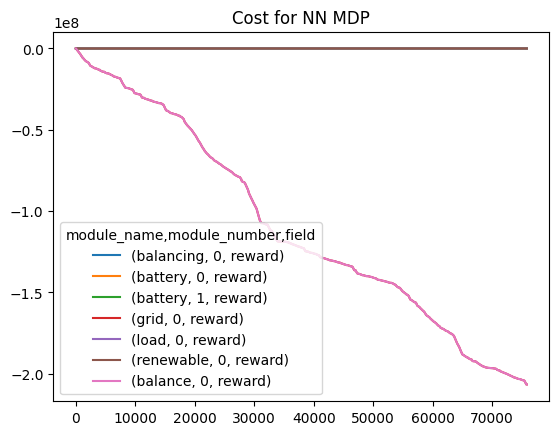

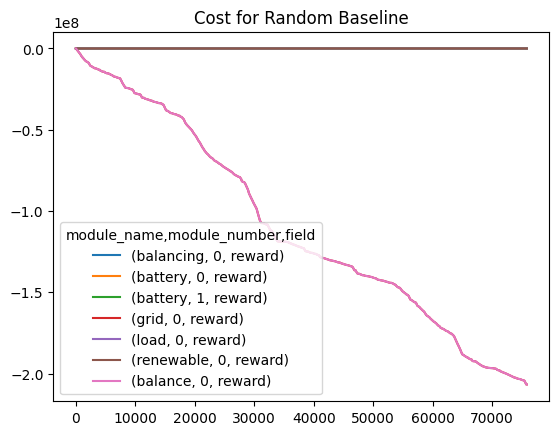

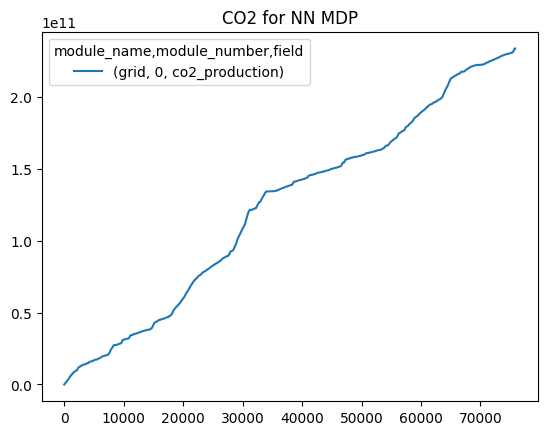

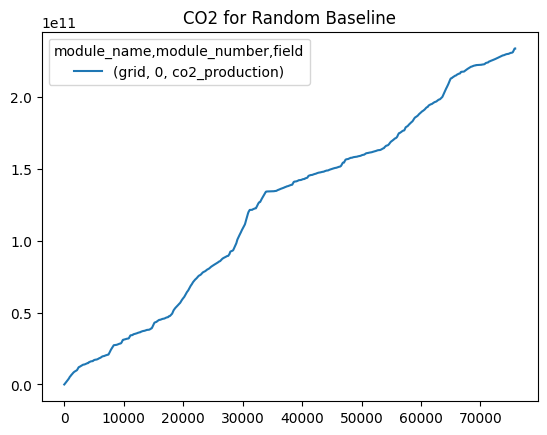

In [13]:
microgrid_log = analyze_performance(microgrid=ucsd_microgrid, end_step=75843)

/var/folders/0s/_3h9xvr52dj7y_2clp586xbm0000gn/T/ipykernel_25026/1825297697.py:1: PerformanceWarning:

indexing past lexsort depth may impact performance.



<AxesSubplot:>

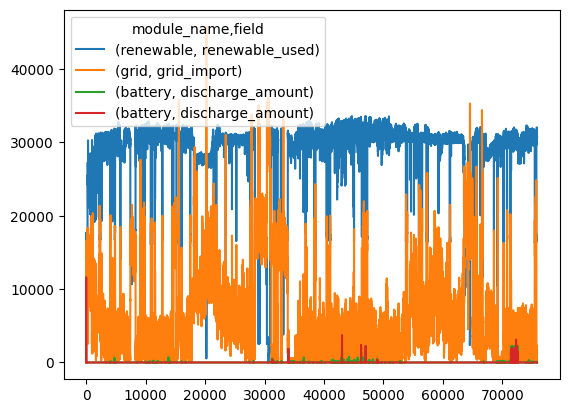

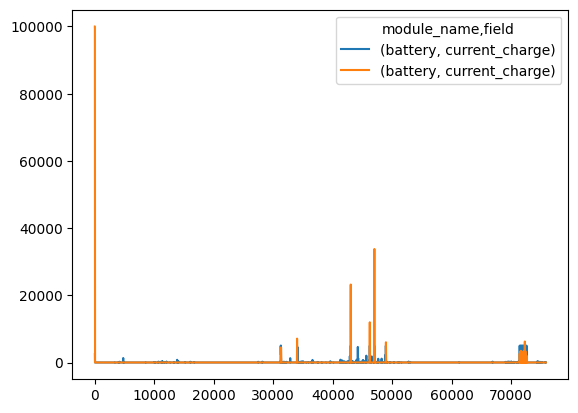

In [22]:
microgrid_log[[('renewable', 0, 'renewable_used'), ('grid', 0, 'grid_import'), ('battery', 0, 'discharge_amount'), ('battery', 1, 'discharge_amount')]].droplevel(axis=1, level=1).plot()
microgrid_log[[('battery', 0, 'current_charge'), ('battery', 1, 'current_charge')]].droplevel(axis=1, level=1).plot()

In [18]:
microgrid_log.to_csv("ucsd_pymgrid.csv")

/Users/jazz/opt/anaconda3/lib/python3.9/site-packages/pymgrid/envs/base/base.py:147: PerformanceWarning:

indexing past lexsort depth may impact performance.

  0%|          | 0/1 [00:00<?, ?it/s]

step 2
reward -49.401328788303175
action 0 {'battery': [0.0], 'grid': [199.984873596959]}
step 3
reward -49.40392573891553
action 1 {'battery': [0.0], 'grid': [200.1421107882485]}
step 4
reward -49.308785534216106
action 0 {'battery': [0.0], 'grid': [202.1916188899254]}
step 5
reward -49.81334821220042
action 0 {'battery': [0.0], 'grid': [306.22845842399994]}
step 6
reward -75.22334384357157
action 0 {'battery': [0.0], 'grid': [523.8375656257573]}
step 7
reward -129.23104776654571
action 0 {'battery': [0.0], 'grid': [611.1857306612502]}
step 8
reward -151.24102267671265
action 0 {'battery': [0.0], 'grid': [567.965259166494]}
step 9
reward -179.9094244693659
action 0 {'battery': [0.0], 'grid': [393.55727213101534]}
step 10
reward -124.62940817406898
action 1 {'battery': [0.0], 'grid': [449.9302538200571]}
step 11
reward -142.51366756728132
action 1 {'battery': [0.0], 'grid': [482.88742619720847]}
step 12
reward -153.0353999819504
action 0 {'battery': [0.0], 'grid': [470.2427863799458]}


100%|██████████| 1/1 [00:43<00:00, 43.73s/it]

step 8759
reward -124.89505215323517
action 1 {'battery': [0.0], 'grid': [533.3235970070422]}
Episode 1: Total Reward = -978200.8883457126



/Users/jazz/opt/anaconda3/lib/python3.9/site-packages/pymgrid/envs/base/base.py:147: PerformanceWarning:

indexing past lexsort depth may impact performance.



Total Reward during Inference: -955985.3951273313


/Users/jazz/opt/anaconda3/lib/python3.9/site-packages/pymgrid/envs/base/base.py:147: PerformanceWarning:

indexing past lexsort depth may impact performance.



Total Reward for Random: -978296.3862348702


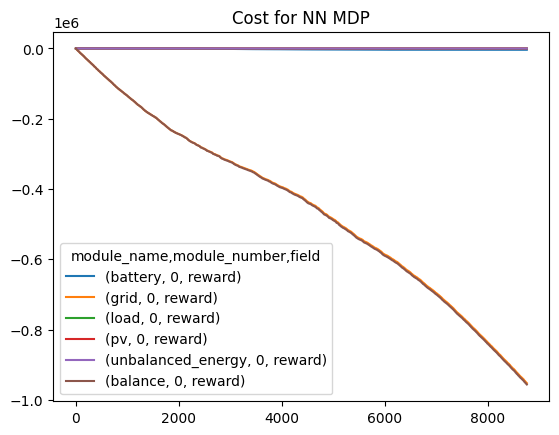

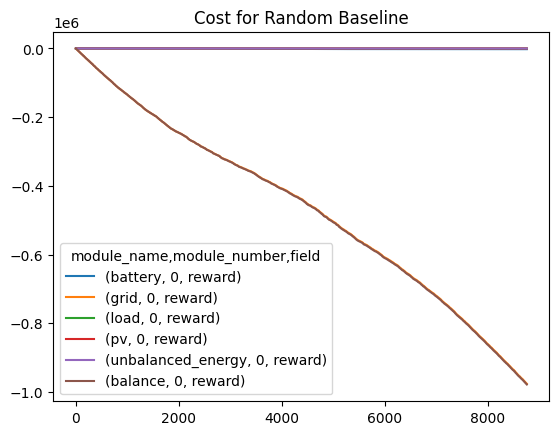

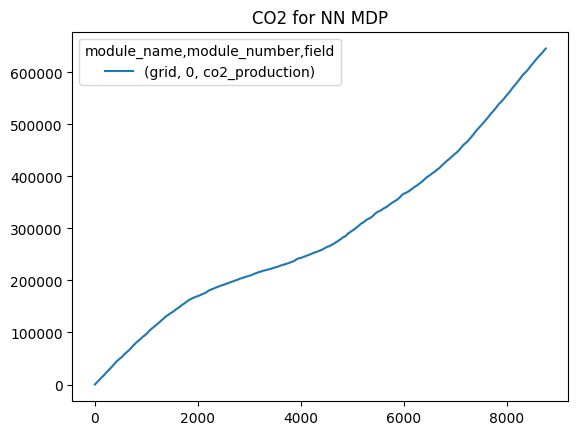

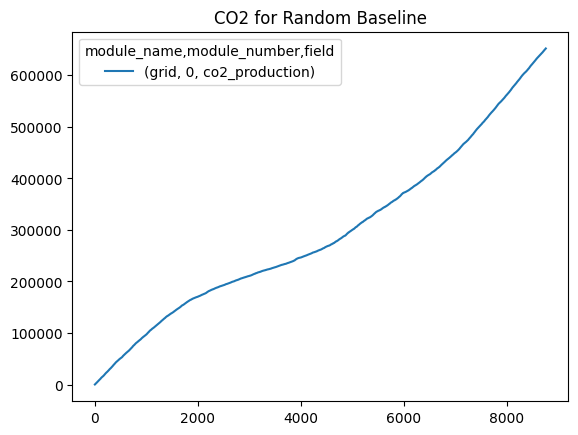

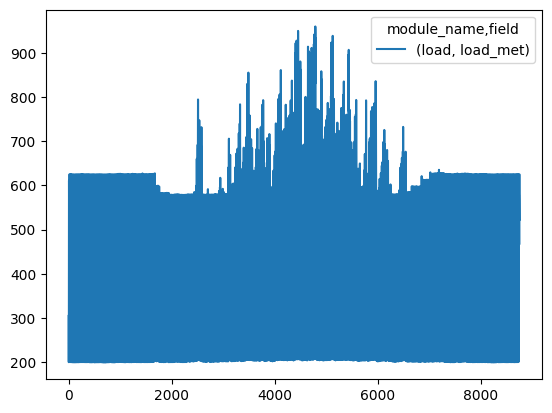

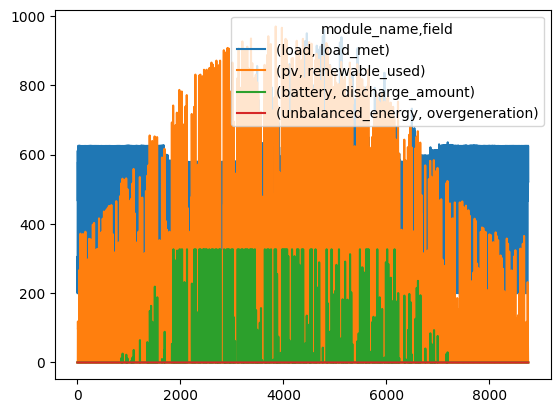

In [5]:
analyze_performance(0)

/Users/jazz/opt/anaconda3/lib/python3.9/site-packages/pymgrid/envs/base/base.py:147: PerformanceWarning:

indexing past lexsort depth may impact performance.

  0%|          | 0/1 [00:00<?, ?it/s]

step 2
reward -7534.417879211547
action 2 {'genset': [array([1.00000000e+00, 1.25746739e+04])], 'battery': [0.0], 'grid': [0.0]}
step 3
reward -1345.971874882818
action 0 {'genset': [array([0., 0.])], 'battery': [0.0], 'grid': [12584.560659907338]}
step 4
reward -1338.6054880316053
action 0 {'genset': [array([0., 0.])], 'battery': [0.0], 'grid': [12713.42988651309]}
step 5
reward -1352.2897514434317
action 0 {'genset': [array([0., 0.])], 'battery': [0.0], 'grid': [19255.07128734157]}
step 6
reward -2611.8449755065003
action 0 {'genset': [array([0., 0.])], 'battery': [0.0], 'grid': [32937.92393111207]}
step 7
reward -19762.754358667244
action 2 {'genset': [array([1.00000000e+00, 3.79698744e+04])], 'battery': [0.0], 'grid': [0.0]}
step 8
reward -5219.152667013144
action 0 {'genset': [array([0., 0.])], 'battery': [0.0], 'grid': [34043.86388863101]}
step 9
reward -4655.883719052486
action 0 {'genset': [array([0., 0.])], 'battery': [0.0], 'grid': [26729.974266922305]}
step 10
reward -3653.2

100%|██████████| 1/1 [02:10<00:00, 130.43s/it]

step 8752
reward -13598.662958364117
action 2 {'genset': [array([1.00000000e+00, 3.54594243e+04])], 'battery': [0.0], 'grid': [0.0]}
step 8753
reward -21275.65456601659
action 2 {'genset': [array([1.00000000e+00, 3.93200708e+04])], 'battery': [0.0], 'grid': [0.0]}
step 8754
reward -23592.04249905506
action 2 {'genset': [array([1.00000000e+00, 3.93223085e+04])], 'battery': [0.0], 'grid': [0.0]}
step 8755
reward -5063.047856672378
action 6 {'genset': [array([0., 0.])], 'battery': [0.0], 'grid': [33015.1348877741]}
step 8756
reward -19809.08093266446
action 2 {'genset': [array([1.00000000e+00, 3.29999997e+04])], 'battery': [0.0], 'grid': [0.0]}
step 8757
reward -19799.999790822203
action 2 {'genset': [array([1.00000000e+00, 3.29381411e+04])], 'battery': [0.0], 'grid': [0.0]}
step 8758
reward -19762.884648074454
action 2 {'genset': [array([1.00000000e+00, 3.28425587e+04])], 'battery': [0.0], 'grid': [0.0]}
step 8759
reward -19705.535221852384
action 2 {'genset': [array([1.00000000e+00, 3.3


/Users/jazz/opt/anaconda3/lib/python3.9/site-packages/pymgrid/envs/base/base.py:147: PerformanceWarning:

indexing past lexsort depth may impact performance.



Total Reward during Inference: -130454012.78819162


/Users/jazz/opt/anaconda3/lib/python3.9/site-packages/pymgrid/envs/base/base.py:147: PerformanceWarning:

indexing past lexsort depth may impact performance.



Total Reward for Random: -142772612.6000594


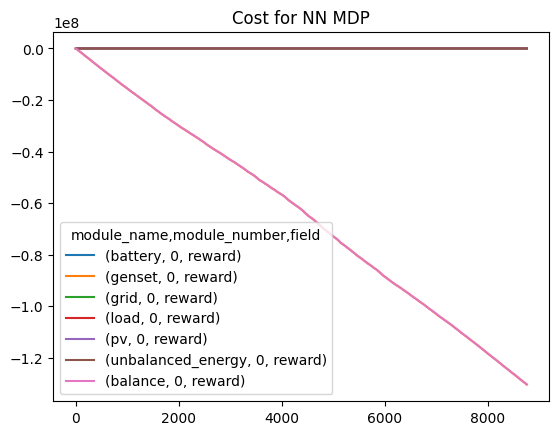

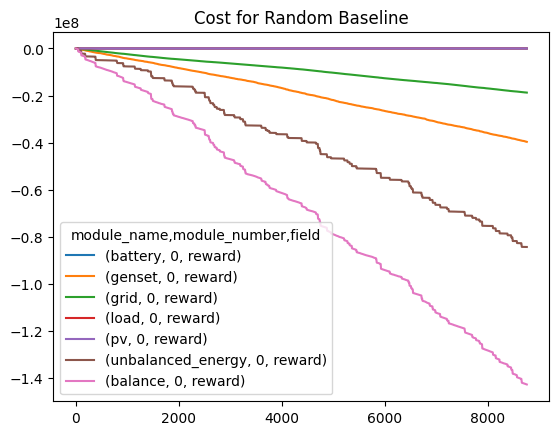

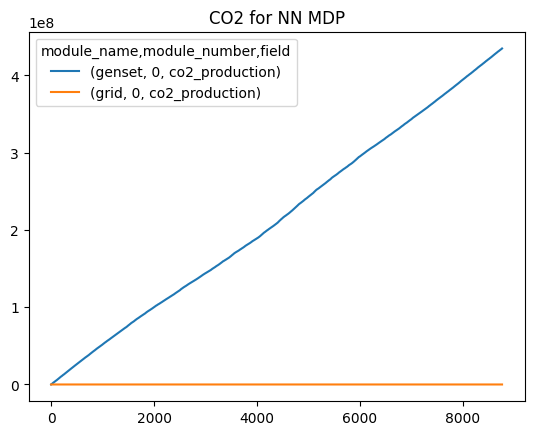

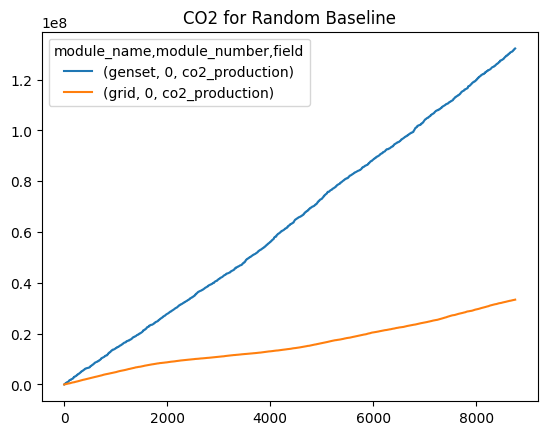

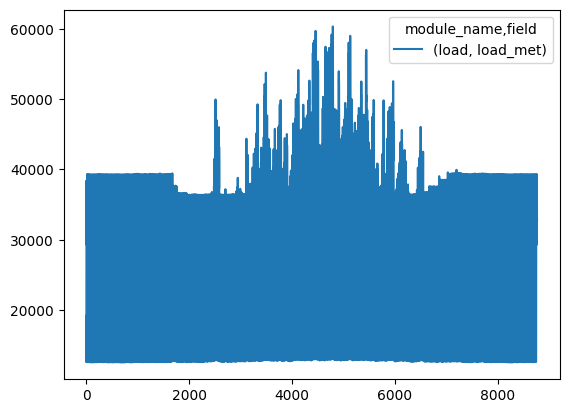

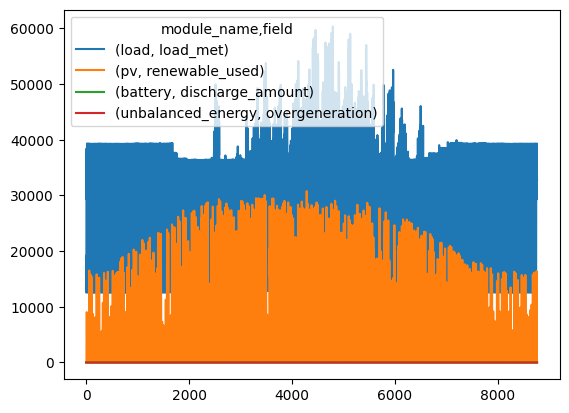

In [3]:
analyze_performance(1)

/Users/jazz/opt/anaconda3/lib/python3.9/site-packages/pymgrid/envs/base/base.py:147: PerformanceWarning:

indexing past lexsort depth may impact performance.

  0%|          | 0/1 [00:00<?, ?it/s]

step 2
reward -90961.4669495455
action 0 {'genset': [array([0., 0.])], 'battery': [0.0]}
step 3
reward -91086.86039611492
action 2 {'genset': [array([0., 0.])], 'battery': [0.0]}
step 4
reward -91158.47702308508
action 0 {'genset': [array([0., 0.])], 'battery': [0.0]}
step 5
reward -92091.9639162707
action 0 {'genset': [array([0., 0.])], 'battery': [0.0]}
step 6
reward -139477.49317280622
action 0 {'genset': [array([0., 0.])], 'battery': [0.0]}
step 7
reward -238591.64121860664
action 0 {'genset': [array([0., 0.])], 'battery': [0.0]}
step 8
reward -275840.0325675419
action 0 {'genset': [array([0., 0.])], 'battery': [0.0]}
step 9
reward -194784.02813271497
action 0 {'genset': [array([0., 0.])], 'battery': [0.0]}
step 10
reward -66607.0825249684
action 0 {'genset': [array([0., 0.])], 'battery': [0.0]}
step 11
reward -54396.96343436881
action 0 {'genset': [array([0., 0.])], 'battery': [0.0]}
step 12
reward -39367.025123328494
action 0 {'genset': [array([0., 0.])], 'battery': [0.0]}
step 1

100%|██████████| 1/1 [00:47<00:00, 47.23s/it]

step 8746
reward -9115.632392578658
action 1 {'genset': [array([1.00000000e+00, 1.30055435e+04])], 'battery': [0.0]}
step 8747
reward -7803.326072727381
action 1 {'genset': [array([1.00000000e+00, 6.22584406e+03])], 'battery': [0.0]}
step 8748
reward -3735.506433762944
action 3 {'genset': [array([1.00000000e+00, 9.22703844e+03])], 'battery': [0.0]}
step 8749
reward -5536.223063094408
action 1 {'genset': [array([1.00000000e+00, 6.48146768e+03])], 'battery': [0.0]}
step 8750
reward -3888.8806051301062
action 1 {'genset': [array([1.00000000e+00, 8.56063942e+03])], 'battery': [0.0]}
step 8751
reward -85606.39419327729
action 0 {'genset': [array([0., 0.])], 'battery': [0.0]}
step 8752
reward -8935.025290437403
action 1 {'genset': [array([1.00000000e+00, 2.58466568e+04])], 'battery': [0.0]}
step 8753
reward -258466.5679169177
action 0 {'genset': [array([0., 0.])], 'battery': [0.0]}
step 8754
reward -17089.310641803462
action 1 {'genset': [array([1.00000000e+00, 2.84838053e+04])], 'battery': 


/Users/jazz/opt/anaconda3/lib/python3.9/site-packages/pymgrid/envs/base/base.py:147: PerformanceWarning:

indexing past lexsort depth may impact performance.



Total Reward during Inference: -73169412.57240012


/Users/jazz/opt/anaconda3/lib/python3.9/site-packages/pymgrid/envs/base/base.py:147: PerformanceWarning:

indexing past lexsort depth may impact performance.



Total Reward for Random: -567429085.6730032


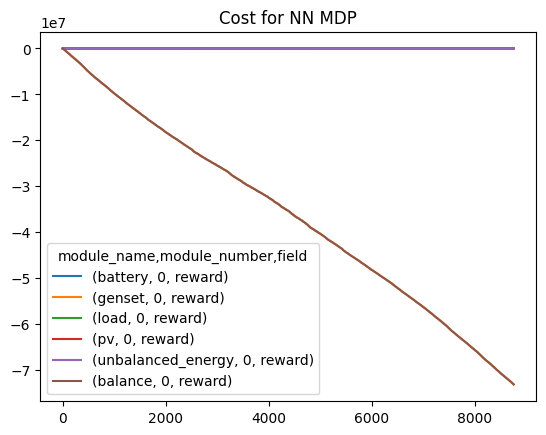

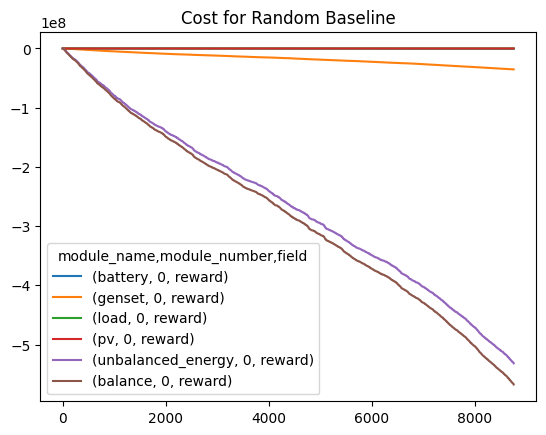

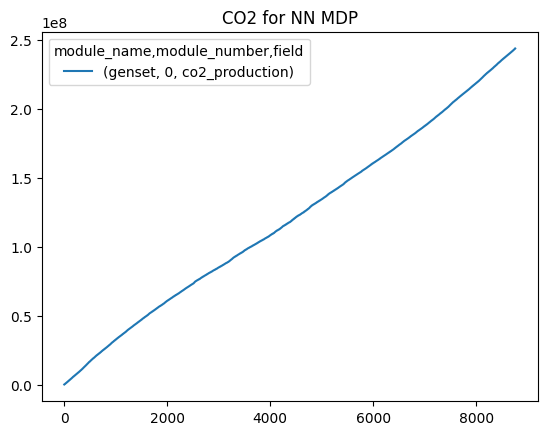

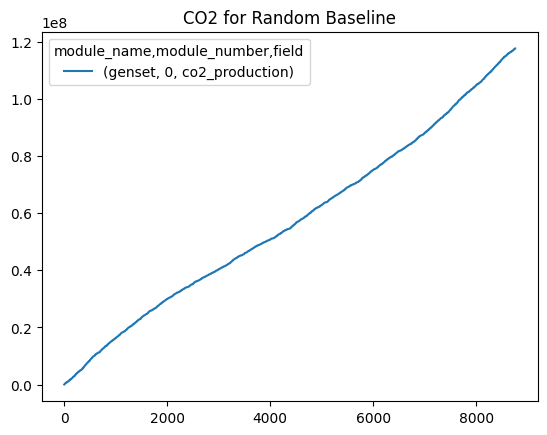

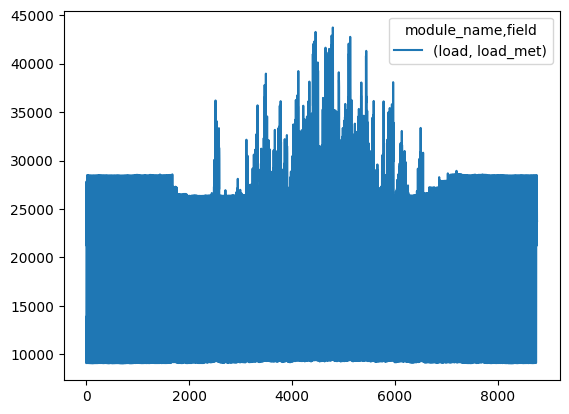

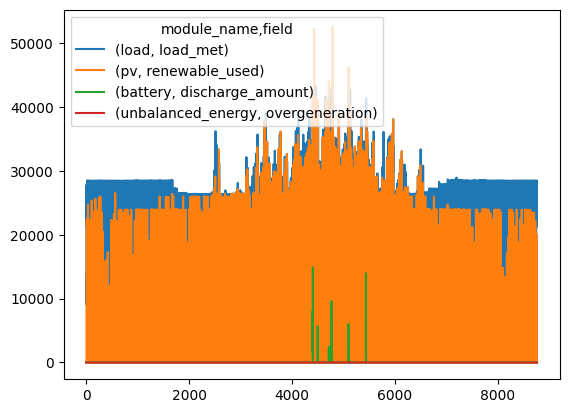

In [4]:
analyze_performance(2)

/Users/jazz/opt/anaconda3/lib/python3.9/site-packages/pymgrid/envs/base/base.py:147: PerformanceWarning:

indexing past lexsort depth may impact performance.

  0%|          | 0/1 [00:00<?, ?it/s]

step 2
reward -7111.120532871703
action 1
step 3
reward -118500.2151961044
action 0
step 4
reward -118477.20228162236
action 0
step 5
reward -118920.16982328119
action 0
step 6
reward -126893.24454206777
action 0
step 7
reward -129528.33736211873
action 0
step 8
reward -110785.77700682275
action 0
step 9
reward -56611.27489429289
action 0
step 10
reward -3.2139959006833925
action 0
step 11
reward -59.61112158892641
action 0
step 12
reward -8.429460354217426
action 0
step 13
reward -92.42726036529017
action 0
step 14
reward -3806.9561818536035
action 3
step 15
reward -14305.091205158606
action 0
step 16
reward -4310.061203208874
action 1
step 17
reward -97778.86450251425
action 0
step 18
reward -6774.502196035894
action 1
step 19
reward -118893.64302916112
action 0
step 20
reward -119283.38748284448
action 0
step 21
reward -7154.33834359365
action 1
step 22
reward -7137.308290738432
action 1
step 23
reward -118597.65376348619
action 0
step 24
reward -120107.03502754128
action 0
step 25


100%|██████████| 1/1 [00:48<00:00, 48.18s/it]

step 8727
reward -71956.02889799344
action 0
step 8728
reward -99131.83261172513
action 0
step 8729
reward -111276.02979467637
action 0
step 8730
reward -112985.11742953431
action 0
step 8731
reward -118965.72733598185
action 0
step 8732
reward -119348.20404476841
action 2
step 8733
reward -119275.83644713342
action 0
step 8734
reward -118989.5349488823
action 0
step 8735
reward -118624.70376988544
action 2
step 8736
reward -120141.12737797806
action 2
step 8737
reward -118560.05298665799
action 0
step 8738
reward -118528.26291139236
action 0
step 8739
reward -118509.47324769656
action 0
step 8740
reward -118488.50401757065
action 0
step 8741
reward -118928.40858823633
action 0
step 8742
reward -118887.6018584278
action 0
step 8743
reward -123548.73393252505
action 0
step 8744
reward -103291.63517190085
action 0
step 8745
reward -71071.4586890246
action 0
step 8746
reward -19641.587927525434
action 0
step 8747
reward -47.219141803460644
action 0
step 8748
reward -10.751836987623108
act


/Users/jazz/opt/anaconda3/lib/python3.9/site-packages/pymgrid/envs/base/base.py:147: PerformanceWarning:

indexing past lexsort depth may impact performance.



Total Reward during Inference: -1685375686.171713


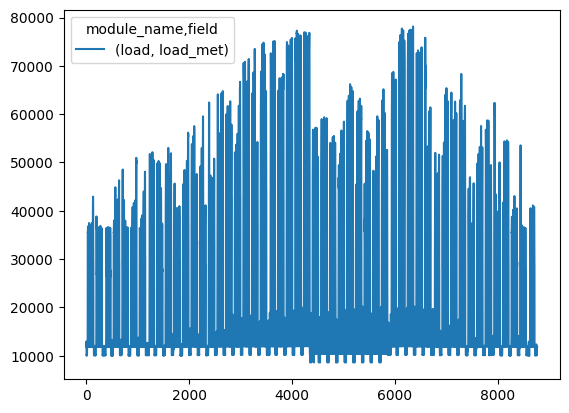

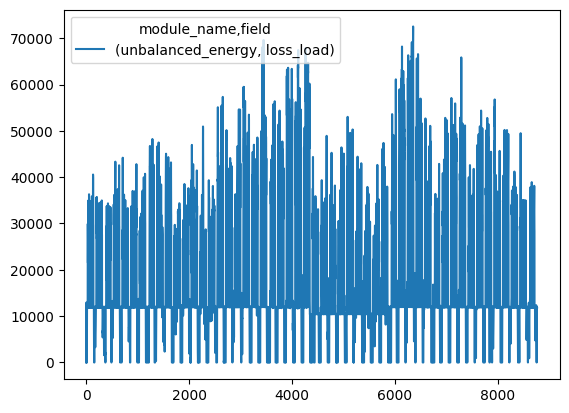

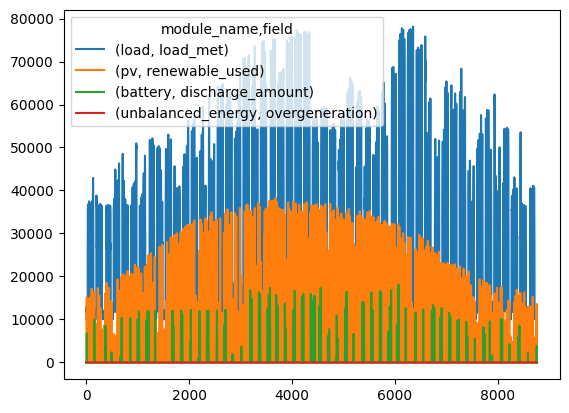

In [9]:
analyze_performance(3)

/Users/jazz/opt/anaconda3/lib/python3.9/site-packages/pymgrid/envs/base/base.py:147: PerformanceWarning:

indexing past lexsort depth may impact performance.

  0%|          | 0/1 [00:00<?, ?it/s]

step 2
reward -811.1167745534902
action 0
step 3
reward -808.5163021756683
action 0
step 4
reward -803.3036133643666
action 0
step 5
reward -806.2930803156491
action 0
step 6
reward -1097.1630038004002
action 0
step 7
reward -1128.6665021718197
action 0
step 8
reward -1000.1658966394955
action 0
step 9
reward -927.0752603496677
action 0
step 10
reward -131.0865466163928
action 0
step 11
reward -45.165789796365544
action 0
step 12
reward -12.810366919519677
action 0
step 13
reward -18.265202697672322
action 0
step 14
reward -85.58347862851411
action 1
step 15
reward 0.0
action 1
step 16
reward -225.79435221535545
action 1
step 17
reward -356.95662442945974
action 0
step 18
reward -919.2940033697907
action 0
step 19
reward -950.6630485749739
action 0
step 20
reward -948.2407040075732
action 0
step 21
reward -947.842526698517
action 1
step 22
reward -948.2849654198999
action 0
step 23
reward -949.8689332103971
action 0
step 24
reward -983.471883104964
action 0
step 25
reward -793.74209599

100%|██████████| 1/1 [00:42<00:00, 42.86s/it]

step 8726
reward -26.956161652154982
action 0
step 8727
reward -32.97535178318386
action 0
step 8728
reward -367.46913061310545
action 0
step 8729
reward -764.4528950615138
action 0
step 8730
reward -997.4741783556999
action 0
step 8731
reward -1035.200163024181
action 0
step 8732
reward -1017.706393900772
action 0
step 8733
reward -1011.0480542122438
action 0
step 8734
reward -1012.4723270163353
action 0
step 8735
reward -1013.1831657200566
action 0
step 8736
reward -1030.1298009948446
action 0
step 8737
reward -817.1658071754246
action 0
step 8738
reward -833.1141298741309
action 0
step 8739
reward -830.3985103311562
action 0
step 8740
reward -826.2340114573308
action 0
step 8741
reward -828.0343415873733
action 0
step 8742
reward -1055.481623211047
action 0
step 8743
reward -1099.2894923085285
action 0
step 8744
reward -956.9752943423947
action 0
step 8745
reward -475.10329979148986
action 0
step 8746
reward -69.37141564242157
action 0
step 8747
reward -199.379207471894
action 0
ste


/Users/jazz/opt/anaconda3/lib/python3.9/site-packages/pymgrid/envs/base/base.py:147: PerformanceWarning:

indexing past lexsort depth may impact performance.



Total Reward during Inference: -8126333.963492049


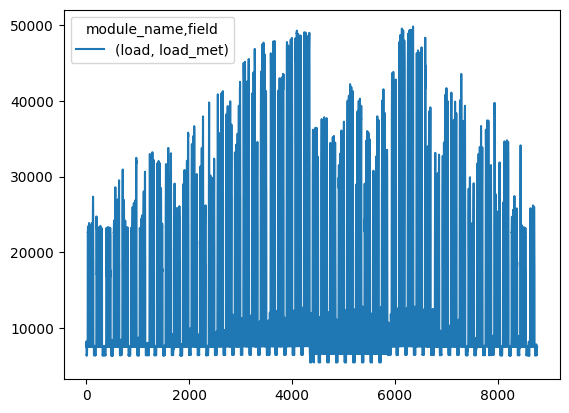

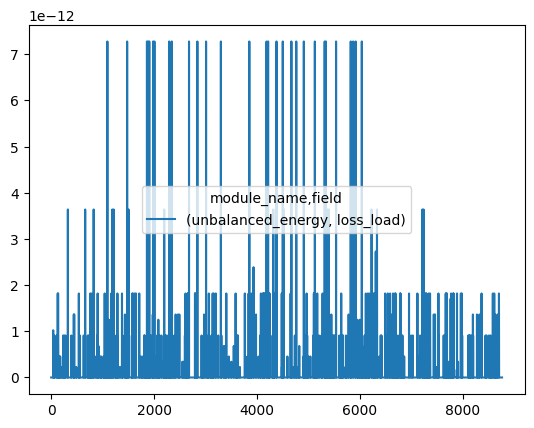

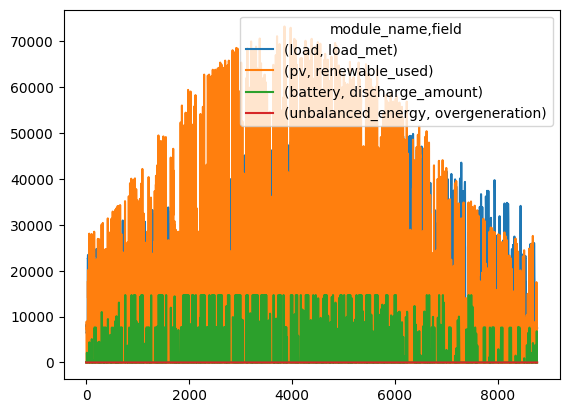

In [10]:
analyze_performance(4)

/Users/jazz/opt/anaconda3/lib/python3.9/site-packages/pymgrid/envs/base/base.py:147: PerformanceWarning:

indexing past lexsort depth may impact performance.

  0%|          | 0/1 [00:00<?, ?it/s]

step 2
reward -132.03021389131666
action 2
step 3
reward -3569.7299937057187
action 1
step 4
reward -3572.5366775702364
action 1
step 5
reward -3609.1203971851683
action 1
step 6
reward -202.45103640253328
action 0
step 7
reward -73079.62406951202
action 0
step 8
reward -179141.8876842219
action 0
step 9
reward -129278.51616453196
action 0
step 10
reward -56815.114587365286
action 0
step 11
reward -3732.0476471570414
action 3
step 12
reward -86790.70530952138
action 0
step 13
reward -47756.65591288141
action 0
step 14
reward -6746.645386563172
action 1
step 15
reward -73970.37912316475
action 0
step 16
reward -115419.3310588011
action 0
step 17
reward -175085.16812745313
action 2
step 18
reward -11164.484307799694
action 1
step 19
reward -11165.164703469223
action 1
step 20
reward -9373.838692366437
action 1
step 21
reward -9368.697217531797
action 3
step 22
reward -9350.805491526238
action 1
step 23
reward -9323.66952743723
action 3
step 24
reward -158660.4183578248
action 2
step 25
r

100%|██████████| 1/1 [00:45<00:00, 45.79s/it]

step 8725
reward -126583.7593610664
action 0
step 8726
reward -104715.32648287035
action 0
step 8727
reward -6927.660988856507
action 1
step 8728
reward -7605.322740671585
action 1
step 8729
reward -175660.14745839074
action 0
step 8730
reward -186035.77217339282
action 0
step 8731
reward -186078.20223091447
action 0
step 8732
reward -156231.6408844662
action 0
step 8733
reward -156156.58144333382
action 0
step 8734
reward -155865.45505582506
action 0
step 8735
reward -155418.64968770547
action 0
step 8736
reward -158690.27189133424
action 0
step 8737
reward -90685.11992111936
action 0
step 8738
reward -3568.704960139521
action 1
step 8739
reward -59574.41708628008
action 0
step 8740
reward -59628.078991173126
action 2
step 8741
reward -60241.66179067847
action 0
step 8742
reward -5469.187767919592
action 3
step 8743
reward -155909.32168271585
action 0
step 8744
reward -178327.53165131633
action 0
step 8745
reward -145469.3517518106
action 0
step 8746
reward -73898.49612763064
action 0


/Users/jazz/opt/anaconda3/lib/python3.9/site-packages/pymgrid/envs/base/base.py:147: PerformanceWarning:

indexing past lexsort depth may impact performance.



Total Reward during Inference: -815529856.2250878


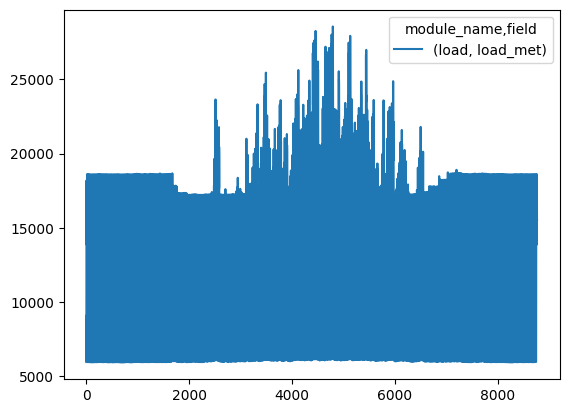

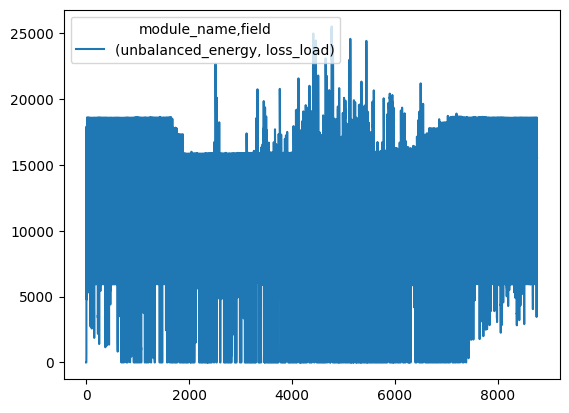

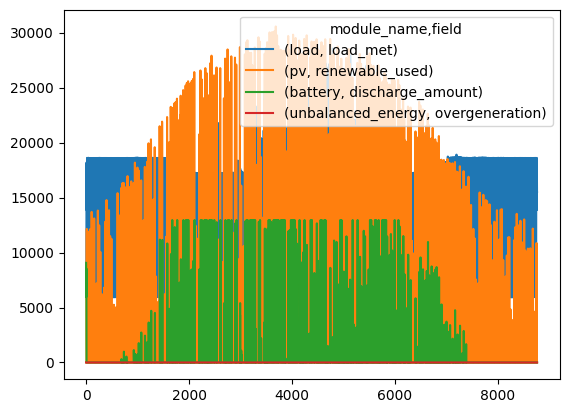

In [11]:
analyze_performance(5)

/Users/jazz/opt/anaconda3/lib/python3.9/site-packages/pymgrid/envs/base/base.py:147: PerformanceWarning:

indexing past lexsort depth may impact performance.

  0%|          | 0/1 [00:00<?, ?it/s]

step 2
reward -2953.0647075980037
action 1
step 3
reward -613.6685615111659
action 0
step 4
reward -613.1802599514111
action 0
step 5
reward -1926.0911029280044
action 0
step 6
reward -3778.6334467842075
action 0
step 7
reward -4134.169338353498
action 0
step 8
reward -4184.389294196961
action 0
step 9
reward -4500.59523821881
action 0
step 10
reward -3902.430148710433
action 0
step 11
reward -3629.2500744455824
action 0
step 12
reward -3833.8577562819105
action 0
step 13
reward -3827.665442614433
action 0
step 14
reward -3977.9424146068764
action 0
step 15
reward -2980.3477299144406
action 0
step 16
reward -3282.5697105914783
action 1
step 17
reward -3359.9478262533994
action 0
step 18
reward -3985.034555421581
action 0
step 19
reward -3845.8132011292787
action 0
step 20
reward -3798.718265271161
action 0
step 21
reward -3645.0535931108357
action 0
step 22
reward -3663.1269910935093
action 0
step 23
reward -3600.431388520807
action 0
step 24
reward -3647.7632258651865
action 0
step 25

100%|██████████| 1/1 [00:39<00:00, 39.34s/it]

step 8725
reward -4412.76282515443
action 0
step 8726
reward -4502.416845435018
action 0
step 8727
reward -3790.9328070314677
action 0
step 8728
reward -3758.616606468393
action 0
step 8729
reward -3947.8855984895863
action 0
step 8730
reward -4847.601962310512
action 0
step 8731
reward -4579.676725347335
action 0
step 8732
reward -4467.145342994387
action 0
step 8733
reward -3911.50126424943
action 0
step 8734
reward -3908.549061404601
action 0
step 8735
reward -3874.9654490054245
action 0
step 8736
reward -3894.1311401678395
action 0
step 8737
reward -3034.3244392371707
action 0
step 8738
reward -3082.8568979038673
action 0
step 8739
reward -3064.5916694718157
action 0
step 8740
reward -3052.828732635133
action 0
step 8741
reward -3085.790806492015
action 0
step 8742
reward -3919.3425148921465
action 0
step 8743
reward -4288.908151040454
action 0
step 8744
reward -4264.306425163377
action 0
step 8745
reward -4321.75437354468
action 0
step 8746
reward -3535.9876464833324
action 0
step


/Users/jazz/opt/anaconda3/lib/python3.9/site-packages/pymgrid/envs/base/base.py:147: PerformanceWarning:

indexing past lexsort depth may impact performance.



Total Reward during Inference: -29242959.20128072


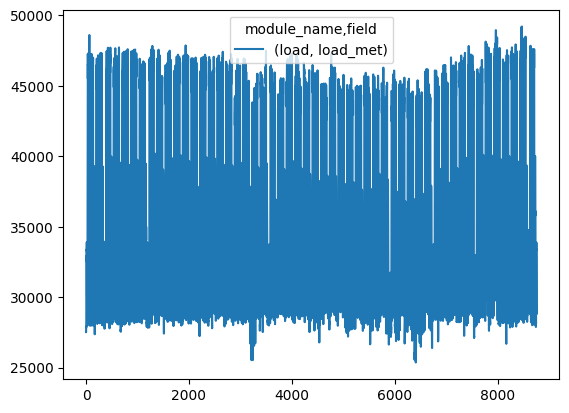

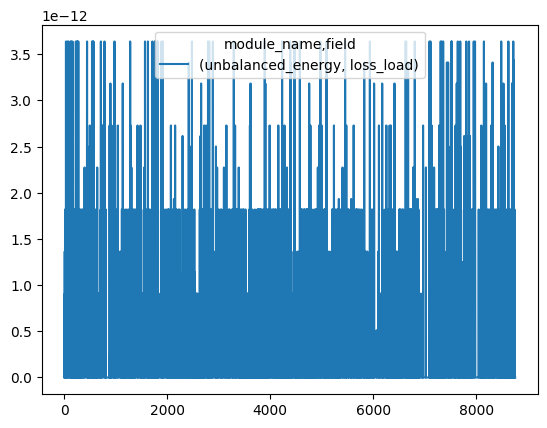

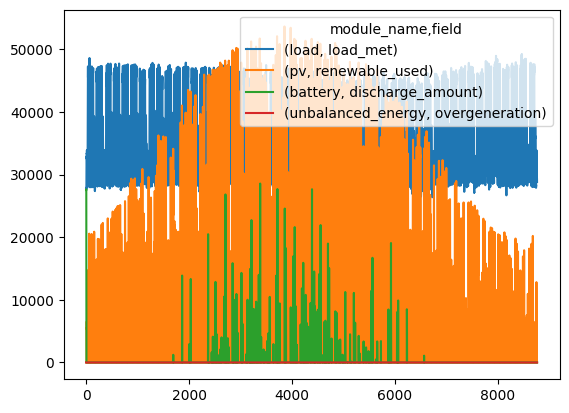

In [12]:
analyze_performance(6)

/Users/jazz/opt/anaconda3/lib/python3.9/site-packages/pymgrid/envs/base/base.py:147: PerformanceWarning:

indexing past lexsort depth may impact performance.

  0%|          | 0/1 [00:00<?, ?it/s]

step 2
reward -39.76219558051344
action 0
step 3
reward -39.7560022602315
action 2
step 4
reward -1073.2036028397106
action 1
step 5
reward -39.89689413185896
action 0
step 6
reward -42.571805531948065
action 0
step 7
reward -1173.3082453823765
action 1
step 8
reward -34.96461403161487
action 0
step 9
reward -23.598580867109135
action 0
step 10
reward -402.5288072628698
action 3
step 11
reward -393.27
action 3
step 12
reward -408.83543283945033
action 3
step 13
reward -25.566701907308154
action 0
step 14
reward -15.070671551695389
action 0
step 15
reward -8.480829890981655
action 0
step 16
reward -0.5619786138538327
action 0
step 17
reward -23.18590639583781
action 0
step 18
reward -37.879976866404895
action 0
step 19
reward -16577.55489250106
action 2
step 20
reward -18008.438014544376
action 0
step 21
reward -18001.73258468397
action 0
step 22
reward -17958.88159795685
action 0
step 23
reward -17904.911501421815
action 0
step 24
reward -18132.785638027464
action 0
step 25
reward -178

100%|██████████| 1/1 [00:46<00:00, 46.05s/it]

step 8753
reward -22.817615088757258
action 0
step 8754
reward -1024.615986784242
action 1
step 8755
reward -39.942890322163514
action 0
step 8756
reward -40.072985698740005
action 2
step 8757
reward -40.046060535717686
action 0
step 8758
reward -1088.6619508710678
action 3
step 8759
reward -39.817644152209894
action 2
Episode 1: Total Reward = -146499780.05333346



/Users/jazz/opt/anaconda3/lib/python3.9/site-packages/pymgrid/envs/base/base.py:147: PerformanceWarning:

indexing past lexsort depth may impact performance.



Total Reward during Inference: -163863322.5615293


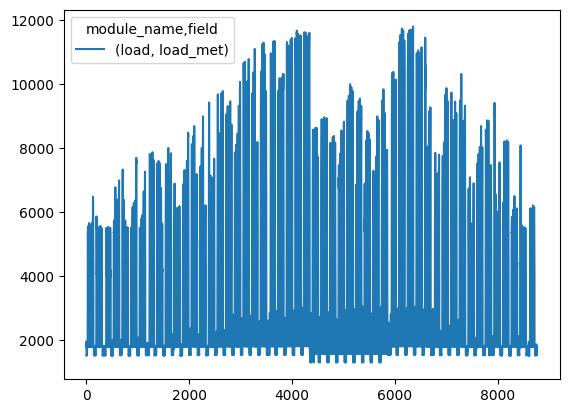

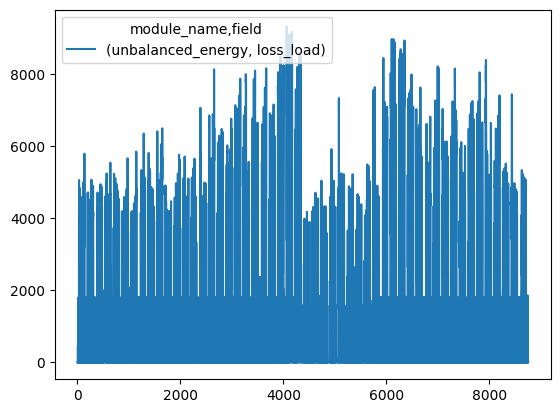

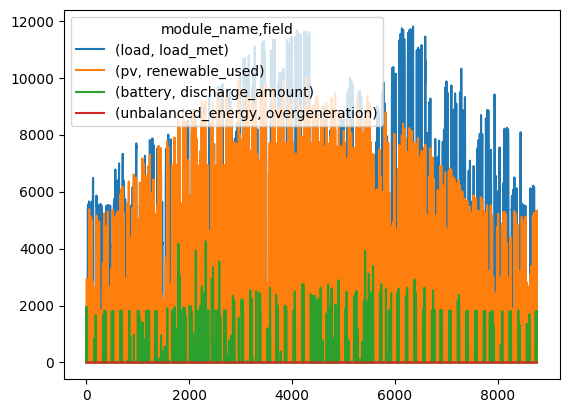

In [13]:
analyze_performance(7)

/Users/jazz/opt/anaconda3/lib/python3.9/site-packages/pymgrid/envs/base/base.py:147: PerformanceWarning:

indexing past lexsort depth may impact performance.

  0%|          | 0/1 [00:00<?, ?it/s]

step 2
reward -8080.561291104635
action 7
step 3
reward -6106.997605401238
action 2
step 4
reward -6006.569387358959
action 2
step 5
reward -6395.13315295501
action 2
step 6
reward -8383.51283588536
action 9
step 7
reward -8863.951050935446
action 11
step 8
reward -2893.5425394301346
action 0
step 9
reward -2419.657093490901
action 0
step 10
reward -489.242837449196
action 0
step 11
reward -53.521645016508195
action 6
step 12
reward -2135.5200000000004
action 3
step 13
reward -2218.859183352372
action 2
step 14
reward -3596.6158825657335
action 1
step 15
reward -39.72507984053611
action 0
step 16
reward -3828.3415940375107
action 1
step 17
reward -4987.822035173955
action 0
step 18
reward -14361.455238900611
action 7
step 19
reward -4419.093398545005
action 1
step 20
reward -8021.789552205694
action 2
step 21
reward -4148.743147829739
action 0
step 22
reward -7481.859774059423
action 2
step 23
reward -2767.2013040764227
action 4
step 24
reward -6331.460697192808
action 2
step 25
reward

100%|██████████| 1/1 [02:06<00:00, 126.09s/it]

step 8745
reward -2769.434201360216
action 0
step 8746
reward -899.3384981283433
action 0
step 8747
reward -2135.5200000000004
action 9
step 8748
reward -8.415294715791246
action 0
step 8749
reward -71.59690619991056
action 0
step 8750
reward -63.018908018745385
action 0
step 8751
reward -649.5522817528827
action 8
step 8752
reward -101.63919334970466
action 0
step 8753
reward -5970.407466360188
action 0
step 8754
reward -8350.687635681204
action 0
step 8755
reward -8233.541420041374
action 5
step 8756
reward -7666.7688531790345
action 5
step 8757
reward -3917.2680159786796
action 0
step 8758
reward -2805.756088069324
action 4
step 8759
reward -2610.084027136995
action 0
Episode 1: Total Reward = -97981860.62301396



/Users/jazz/opt/anaconda3/lib/python3.9/site-packages/pymgrid/envs/base/base.py:147: PerformanceWarning:

indexing past lexsort depth may impact performance.



Total Reward during Inference: -95735843.51050745


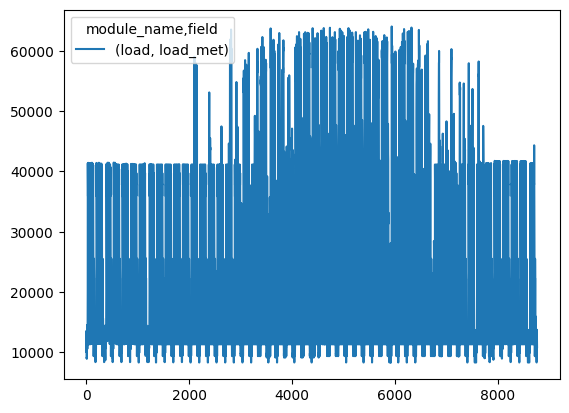

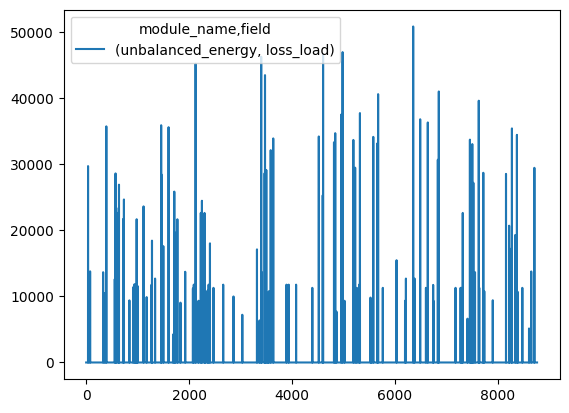

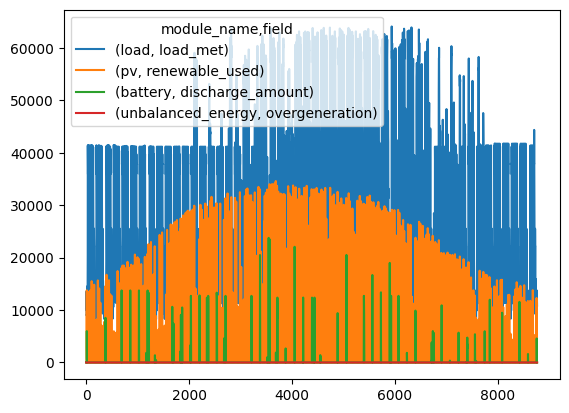

In [14]:
analyze_performance(8)

/Users/jazz/opt/anaconda3/lib/python3.9/site-packages/pymgrid/envs/base/base.py:147: PerformanceWarning:

indexing past lexsort depth may impact performance.

  0%|          | 0/1 [00:00<?, ?it/s]

step 2
reward -457.64926661011145
action 4
step 3
reward -12373.564091627843
action 2
step 4
reward -12383.292749745906
action 2
step 5
reward -12510.100939766908
action 2
step 6
reward -18947.120293838932
action 2
step 7
reward -6703.243126430388
action 1
step 8
reward -6873.676098408749
action 0
step 9
reward -5215.066058389328
action 0
step 10
reward -4690.178885985304
action 9
step 11
reward -4254.573385796251
action 2
step 12
reward -3299.88
action 3
step 13
reward -3299.88
action 3
step 14
reward -3396.0010907456026
action 2
step 15
reward -3299.88
action 3
step 16
reward -12896.441841061174
action 2
step 17
reward -5561.581402272484
action 0
step 18
reward -8056.018206881563
action 0
step 19
reward -8053.523190975474
action 0
step 20
reward -6740.063618029199
action 0
step 21
reward -541236.898778465
action 0
step 22
reward -540203.2799014538
action 0
step 23
reward -538635.6142262932
action 0
step 24
reward -549956.1195991324
action 0
step 25
reward -18851.82823945098
action 9


100%|██████████| 1/1 [02:02<00:00, 122.46s/it]

step 8747
reward -3320.437905278643
action 0
step 8748
reward -1162.8921336466917
action 0
step 8749
reward -2174.048619281007
action 0
step 8750
reward -1446.5413467210462
action 0
step 8751
reward -1661.1784361020154
action 0
step 8752
reward -19257.06372999755
action 3
step 8753
reward -5719.817629931626
action 0
step 8754
reward -8245.616697562004
action 0
step 8755
reward -8281.876769720991
action 0
step 8756
reward -6878.338995964378
action 0
step 8757
reward -6869.452002477201
action 0
step 8758
reward -6882.46993726487
action 0
step 8759
reward -7040.463447499701
action 0
Episode 1: Total Reward = -282765199.8306915



/Users/jazz/opt/anaconda3/lib/python3.9/site-packages/pymgrid/envs/base/base.py:147: PerformanceWarning:

indexing past lexsort depth may impact performance.



Total Reward during Inference: -313210498.04196393


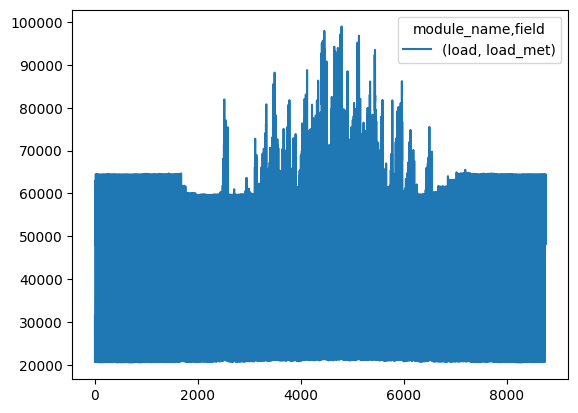

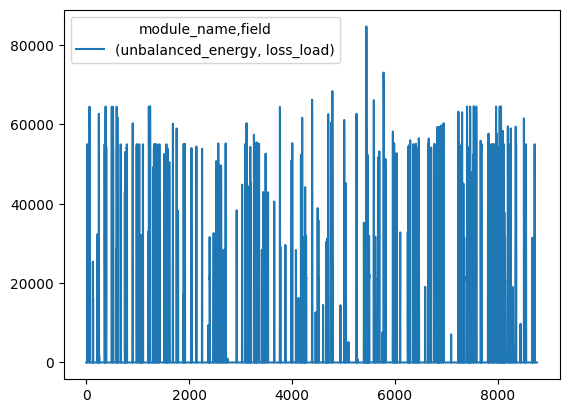

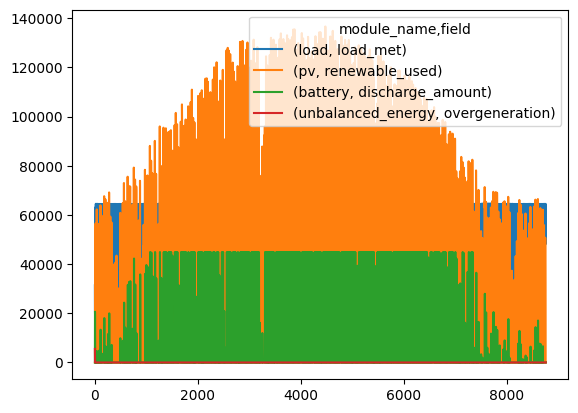

In [15]:
analyze_performance(9)

/Users/jazz/opt/anaconda3/lib/python3.9/site-packages/pymgrid/envs/base/base.py:147: PerformanceWarning:

indexing past lexsort depth may impact performance.

  0%|          | 0/1 [00:00<?, ?it/s]

step 2
reward -8010.728679377323
action 0
step 3
reward -20248.06999787151
action 2
step 4
reward -20231.95842758406
action 2
step 5
reward -20468.345343342426
action 2
step 6
reward -20425.36114661719
action 2
step 7
reward -8651.459555357382
action 8
step 8
reward -8593.9936756434
action 0
step 9
reward -9835.630215414896
action 0
step 10
reward -14308.23532693042
action 2
step 11
reward -5932.762715441013
action 0
step 12
reward -14437.107174542485
action 2
step 13
reward -10326.571129018708
action 0
step 14
reward -21326.209572913984
action 2
step 15
reward -17010.82519454907
action 0
step 16
reward -22136.85257977953
action 2
step 17
reward -23866.884493188623
action 0
step 18
reward -22875.544196334748
action 2
step 19
reward -11421.74956891621
action 0
step 20
reward -22333.978187544457
action 2
step 21
reward -10892.300700695689
action 0
step 22
reward -21476.521841927213
action 2
step 23
reward -13632.013181420949
action 9
step 24
reward -20820.961023170217
action 2
step 25
re

100%|██████████| 1/1 [02:02<00:00, 122.33s/it]

step 8758
reward -8524.733284316313
action 0
step 8759
reward -8483.703216773794
action 0
Episode 1: Total Reward = -110854306.65957187



/Users/jazz/opt/anaconda3/lib/python3.9/site-packages/pymgrid/envs/base/base.py:147: PerformanceWarning:

indexing past lexsort depth may impact performance.



Total Reward during Inference: -103925136.32584839


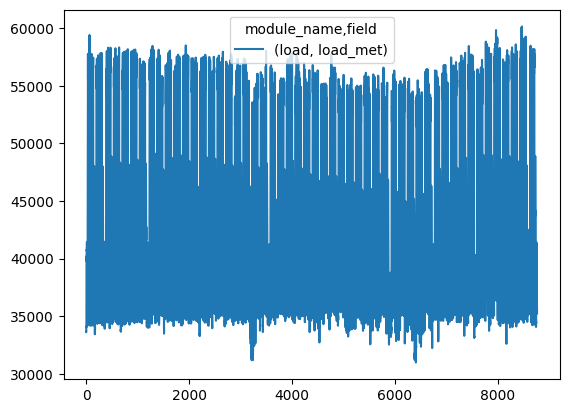

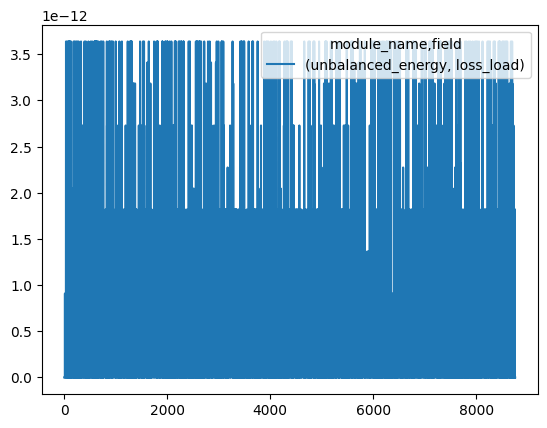

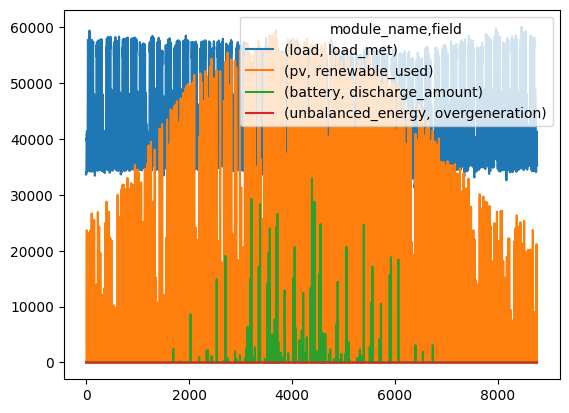

In [16]:
analyze_performance(10)